In [2]:
import pandas as pd

In [3]:
df = pd.read_parquet("../data/movies.parquet")

In [4]:
df.head()

,title_id,title,original_title,release_year,runtime_minutes,genre,imdb_rating,vote_count,production_country
0,tt0000009,Miss Jerry,Miss Jerry,1894,45,Romance,5.4,223,AU|DE|HU|US
1,tt0000147,The Corbett-Fitzsimmons Fight,The Corbett-Fitzsimmons Fight,1897,100,"Documentary,News,Sport",5.3,559,RU|US
2,tt0000502,Bohemios,Bohemios,1905,100,None,3.8,21,ES
3,tt0000574,The Story of the Kelly Gang,The Story of the Kelly Gang,1906,70,"Action,Adventure,Biography",6.0,985,AU|DE|GB|HU|RS|SG|US
4,tt0000591,The Prodigal Son,L'enfant prodigue,1907,90,Drama,5.6,31,FR|US


In [5]:
MOVIE_GENRES = [
    'Drama', 'Comedy', 'Documentary', 'Romance', 'Action',
    'Crime', 'Thriller', 'Horror', 'Adventure', 'Mystery'
]

In [15]:
df_filtered = df[df['genre'].notna()].copy()
df_filtered['genre'] = df_filtered['genre'].str.split(",")

df_exploded = df_filtered.explode('genre')
df_exploded['genre'] = df_exploded['genre'].str.strip()

df_focus = df_exploded[(df_exploded['genre'].isin(MOVIE_GENRES)) & (df_exploded['vote_count'] > 30_000)]


In [34]:
# Step 4: Top 10 by IMDb rating within each genre
top_movies_by_genre = (
    df_focus.sort_values(['genre', 'imdb_rating'], ascending=[True, False])
           .groupby('genre')
           .head(15)
           .reset_index(drop=True)
)

print(top_movies_by_genre.shape)
top_movies_by_genre.head()

(150, 9)


,title_id,title,original_title,release_year,runtime_minutes,genre,imdb_rating,vote_count,production_country
0,tt0468569,The Dark Knight,The Dark Knight,2008,152,Action,9.0,3016995,AE|AL|AR|AU|AZ|BG|BR|CA|CN|CZ|DE|DK|EC|EE|EG|E...
1,tt1375666,Inception,Inception,2010,148,Action,8.8,2679961,AE|AR|AU|BE|BG|BR|CA|CL|CN|CO|CZ|DE|DK|EC|EE|E...
2,tt0080684,Star Wars: Episode V - The Empire Strikes Back,Star Wars: Episode V - The Empire Strikes Back,1980,124,Action,8.7,1439551,AE|AR|AU|AZ|BE|BG|BR|CA|CL|CM|CN|CO|CSHH|CZ|DE...
3,tt0133093,The Matrix,The Matrix,1999,136,Action,8.7,2153140,AE|AR|AT|AU|BE|BG|BR|CA|CN|CZ|DE|DK|EC|EE|EG|E...
4,tt0047478,Seven Samurai,Shichinin no samurai,1954,207,Action,8.6,383592,AE|AR|AU|AZ|BE|BG|BR|CA|CH|CN|CSHH|CZ|DE|DK|EC...


In [35]:
import requests
from tqdm import tqdm
import time # Import time for potential delays

TMDB_API_KEY = "d64993a9f8d47eb7f6e6e426f7d1f63d" # Consider hiding this or loading from env
TMDB_SEARCH_URL = "https://api.themoviedb.org/3/search/movie"
TMDB_IMAGE_BASE = "https://image.tmdb.org/t/p/w342"

def fetch_poster_url_improved(title, year):
    params = {
        "api_key": TMDB_API_KEY,
        "query": title,
        "primary_release_year": year # Use primary_release_year for potentially better filtering
        # "year": year # 'year' searches release dates in general, primary_release_year is often better
    }
    try:
        response = requests.get(TMDB_SEARCH_URL, params=params)
        response.raise_for_status() # Check for HTTP errors (like 4xx, 5xx)
        results = response.json().get("results", [])

        if not results:
            # print(f"No results for {title} ({year})")
            return None

        # --- Improvement: Find best match ---
        best_match = None
        for movie in results:
            # Check if release_date exists and extract year
            release_date = movie.get("release_date")
            if release_date and release_date.startswith(str(year)):
                 # Found a movie released in the target year
                 # Prioritize results with a poster path
                if movie.get("poster_path"):
                    best_match = movie
                    break # Found a good match with a poster in the right year

        # If no match in the target year with a poster was found,
        # maybe fall back to the first result *if* it has a poster? (Optional)
        if not best_match and results[0].get("poster_path"):
             # Check if the first result is at least *close* in year, if desired
             release_date_first = results[0].get("release_date")
             if release_date_first:
                 try:
                    first_result_year = int(release_date_first.split('-')[0])
                    # Allow a small tolerance (e.g., +/- 1 year) if desired, or exact match
                    if abs(first_result_year - int(year)) <= 0: # Exact year match for fallback
                         best_match = results[0]
                 except (ValueError, IndexError):
                     pass # Couldn't parse year from first result

        # --- End Improvement ---

        if best_match and best_match.get("poster_path"):
            # print(f"Found poster for {title} ({year}): {best_match.get('title')} {best_match.get('release_date')}")
            return TMDB_IMAGE_BASE + best_match["poster_path"]
        else:
            # print(f"No suitable match with poster found for {title} ({year}) in results.")
            # Optional: Log which movie was the first result if debugging
            # if results: print(f"  First result was: {results[0].get('title')} ({results[0].get('release_date')})")
            return None

    except requests.exceptions.RequestException as e:
        print(f"Request Error fetching poster for {title} ({year}): {e}")
    except Exception as e:
        print(f"General Error fetching poster for {title} ({year}): {e}")
    return None

# --- Update the way you call the function ---
poster_urls = []
for _, row in tqdm(top_movies_by_genre.iterrows(), total=len(top_movies_by_genre), desc="Fetching posters"):
    # Convert year to int, handle potential NaN/errors if necessary before passing
    try:
        release_year_int = int(row["release_year"])
        poster_url = fetch_poster_url_improved(row["title"], release_year_int)
        poster_urls.append(poster_url)
    except (ValueError, TypeError):
        print(f"Skipping due to invalid year for title: {row['title']} (Year: {row['release_year']})")
        poster_urls.append(None)
    # Optional: Add a small delay to respect API rate limits
    # time.sleep(0.1)


top_movies_by_genre["poster_url"] = poster_urls

print(top_movies_by_genre[['title', 'release_year', 'poster_url']].head())
# Check Gladiator specifically
print("\nGladiator Entry:")
print(top_movies_by_genre[top_movies_by_genre['title_id'] == 'tt0172495'][['title', 'release_year', 'poster_url']])

Fetching posters: 100%|██████████| 150/150 [00:16<00:00,  9.09it/s]

                                            title  release_year  \
0                                 The Dark Knight          2008   
1                                       Inception          2010   
2  Star Wars: Episode V - The Empire Strikes Back          1980   
3                                      The Matrix          1999   
4                                   Seven Samurai          1954   

                                          poster_url  
0  https://image.tmdb.org/t/p/w342/qJ2tW6WMUDux91...  
1  https://image.tmdb.org/t/p/w342/ljsZTbVsrQSqZg...  
2  https://image.tmdb.org/t/p/w342/nNAeTmF4CtdSgM...  
3  https://image.tmdb.org/t/p/w342/dXNAPwY7VrqMAo...  
4  https://image.tmdb.org/t/p/w342/8OKmBV5BUFzmoz...  

Gladiator Entry:
        title  release_year                                         poster_url
8   Gladiator          2000  https://image.tmdb.org/t/p/w342/ty8TGRuvJLPUmA...
28  Gladiator          2000  https://image.tmdb.org/t/p/w342/ty8TGRuvJLPUmA...


In [49]:
# === ADD THIS CODE BLOCK ===

import json # Make sure json is imported
import math # Make sure math is imported (though not strictly needed in this final version)
import pandas as pd # Make sure pandas is imported

# --- Assume 'top_movies_by_genre' DataFrame exists from the previous image download step ---
# --- It should contain columns: genre, title, release_year, imdb_rating, vote_count, title_id, local_poster_path ---

# --- Configuration ---
MAX_MOVIES_PER_GENRE = 10 # Keep this consistent

# 1. Filter out movies without a valid local poster path *first*
#    Make sure the column name matches what your download script created (e.g., 'local_poster_path')
if 'local_poster_path' not in top_movies_by_genre.columns:
    raise ValueError("Error: 'local_poster_path' column not found in DataFrame. Did the download script run correctly?")

movies_with_posters = top_movies_by_genre.dropna(subset=['local_poster_path']).copy()
print(f"Found {len(movies_with_posters)} movies with downloaded posters.")


# 2. Sort by genre, then rating (desc), then maybe vote_count as tie-breaker
#    Ensure column names here also match your DataFrame ('imdb_rating', 'vote_count')
if not all(col in movies_with_posters.columns for col in ['genre', 'imdb_rating', 'vote_count']):
     raise ValueError("Error: One or more required columns ('genre', 'imdb_rating', 'vote_count') missing.")

movies_with_posters = movies_with_posters.sort_values(
    ['genre', 'imdb_rating', 'vote_count'], ascending=[True, False, False]
)

# 3. Group by genre and take the top N (up to MAX_MOVIES_PER_GENRE)
top_movies_filtered = movies_with_posters.groupby('genre').head(MAX_MOVIES_PER_GENRE)
print(f"Selected top {MAX_MOVIES_PER_GENRE} (max) movies per genre with posters. Total: {len(top_movies_filtered)} movies.")


# 4. Prepare data structure for JSON embedding
#    Create a dictionary: { genre: [ list of movie dicts ] }
genre_data_for_js = {}
available_genres = top_movies_filtered['genre'].unique()

for genre in available_genres:
    genre_df = top_movies_filtered[top_movies_filtered['genre'] == genre]
    movie_list = []
    for _, row in genre_df.iterrows():
        # Convert year to int, handle potential issues
        year_val = row.get('release_year')
        year = int(year_val) if pd.notna(year_val) else None

        # Prepare votes string, handle potential issues
        votes_val = row.get('vote_count')
        votes = f"{int(votes_val):,}" if pd.notna(votes_val) else 'N/A'

        # Ensure all needed columns exist before adding
        if not all(col in row for col in ['title', 'imdb_rating', 'title_id', 'local_poster_path']):
             print(f"Warning: Skipping row due to missing data (e.g., title, rating, id, path) for genre {genre}")
             continue

        movie_list.append({
            "title": row['title'],
            "year": year,
            "rating": row['imdb_rating'],
            "votes": votes,
            "imdbId": row['title_id'],
            "posterPath": row['local_poster_path'] # Use the verified local path
        })
    # Only add genre if it has at least one movie with a poster after processing
    if movie_list:
        genre_data_for_js[genre] = movie_list

# 5. Convert the Python dictionary to a JSON string for embedding
#    THIS DEFINES THE MISSING VARIABLE
movies_json = json.dumps(genre_data_for_js, indent=2) # indent for readability

print(f"\nSuccessfully prepared JSON data for {len(genre_data_for_js)} genres.")
# Example: Print the generated JSON structure for debugging if needed
# print("\nSample generated JSON data snippet:")
# print(movies_json[:500] + "...") # Print the first 500 characters

# === END OF ADDED CODE BLOCK ===

Found 147 movies with downloaded posters.
Selected top 10 (max) movies per genre with posters. Total: 100 movies.

Successfully prepared JSON data for 10 genres.


In [50]:
import pandas as pd
import requests
import os
from tqdm import tqdm
from pathlib import Path
import shutil # For safely creating filenames

# --- Configuration ---
IMAGE_FOLDER = "movie_posters"
HTML_FILENAME = "top_movies_visualization.html"

# Ensure the DataFrame exists (replace with your actual DataFrame name if different)
# Example: Assuming top_movies_by_genre is already populated
# Example data structure (ensure yours matches):
# data = {'genre': ['Action', 'Action', 'Comedy', 'Comedy'],
#         'title': ['Movie A', 'Movie B', 'Movie C', 'Movie D'],
#         'release_year': [2020, 2019, 2021, 2018],
#         'imdb_rating': [8.5, 8.2, 7.9, 7.5],
#         'vote_count': [500000, 400000, 300000, 200000],
#         'title_id': ['tt1', 'tt2', 'tt3', 'tt4'],
#         'poster_url_imdb': [ # Replace with actual URLs or None
#             "https://image.tmdb.org/t/p/w342/path1.jpg",
#             "https://image.tmdb.org/t/p/w342/path2.jpg",
#             None, # Example of missing poster
#             "https://image.tmdb.org/t/p/w342/path4.jpg"
#             ]
#        }
# top_movies_by_genre = pd.DataFrame(data)

# Create the image directory if it doesn't exist
Path(IMAGE_FOLDER).mkdir(parents=True, exist_ok=True)

# --- Function to download a single image ---
def download_image(url, filepath):
    if not url or pd.isna(url):
        # print(f"Skipping download: No URL provided for {filepath}")
        return False
    if Path(filepath).exists():
        # print(f"Skipping download: File already exists at {filepath}")
        return True # Already downloaded
    try:
        response = requests.get(url, stream=True, timeout=15)
        response.raise_for_status() # Raise an exception for bad status codes
        with open(filepath, 'wb') as f:
            for chunk in response.iter_content(chunk_size=8192):
                f.write(chunk)
        return True
    except requests.exceptions.RequestException as e:
        print(f"Error downloading {url}: {e}")
        # Optional: Create a placeholder or leave the file missing
        # Create a dummy file to avoid future download attempts for this URL if needed
        # with open(filepath, 'w') as f: f.write('') # Creates an empty file
        return False
    except Exception as e:
        print(f"Unexpected error downloading {url}: {e}")
        return False

# --- Add local image path column and download images ---
local_image_paths = []
print(f"Downloading images to ./{IMAGE_FOLDER}/ ...")

# Create a set of unique valid URLs to download
unique_urls = top_movies_by_genre['poster_url'].dropna().unique()
url_to_local_path = {}

# Generate safe filenames and map URLs to local paths
for url in unique_urls:
    try:
        # Create a filename based on the last part of the URL path, removing problematic chars
        filename_base = Path(url).name
        # Sanitize filename further (replace non-alphanumeric with underscore)
        safe_filename = "".join(c if c.isalnum() or c in ['.', '_'] else '_' for c in filename_base)
        if not safe_filename: # Handle cases where the name becomes empty
             safe_filename = f"poster_{hash(url)}.jpg" # Fallback to hash

        local_path = Path(IMAGE_FOLDER) / safe_filename
        url_to_local_path[url] = str(local_path).replace("\\", "/") # Use forward slashes for HTML
    except Exception as e:
        print(f"Error creating filename for URL {url}: {e}")
        url_to_local_path[url] = None # Mark as unable to process


# Download images based on the generated map
download_progress = tqdm(url_to_local_path.items(), desc="Downloading Posters")
successful_downloads = {}
for url, local_path in download_progress:
    if local_path:
        download_progress.set_postfix({"file": Path(local_path).name})
        if download_image(url, local_path):
            successful_downloads[url] = local_path
        # time.sleep(0.05) # Optional small delay


# Map the successful local paths back to the DataFrame
def get_local_path(url):
    return successful_downloads.get(url, None) # Return None if download failed or URL was invalid

top_movies_by_genre['local_poster_path'] = top_movies_by_genre['poster_url'].apply(get_local_path)

print(f"\nImage download process completed.")
print(f"Successfully mapped {top_movies_by_genre['local_poster_path'].notna().sum()} local poster paths.")

# Display some results
# print(top_movies_by_genre[['title', 'poster_url_imdb', 'local_poster_path']].head())


Image download process completed.
Successfully mapped 147 local poster paths.


In [60]:
import pandas as pd

# --- Configuration ---
MAX_MOVIES_PER_GENRE = 10
HTML_FILENAME = "top_movies_themed_horizontal_scroll_v2.html" # Updated filename
IMAGE_FOLDER = "movie_posters"

# --- DEFINE THE FIXED GENRE-COLOR MAPPING ---
MOVIE_GENRES = [
    'Drama', 'Comedy', 'Documentary', 'Romance', 'Action',
    'Crime', 'Thriller', 'Horror', 'Adventure', 'Mystery'
]

GENRE_COLORS_HEX = [
    '#003f5c', # Drama: Deep Blue
    '#f9a602', # Comedy: Bright Orange-Yellow
    '#428fc9', # Documentary: Medium Blue-Gray (Corrected based on hex)
    '#ff7b9c', # Romance: Soft Pink
    '#ef562f', # Action: Vibrant Orange-Red
    '#2f4f4f', # Crime: Dark Slate Gray
    '#008080', # Thriller: Teal
    '#8b0000', # Horror: Deep Red
    '#556b2f', # Adventure: Dark Olive Green
    '#6a0dad', # Mystery: Rich Purple
]

# Create the specific mapping using the provided lists
GENRE_COLOR_MAP = dict(zip(MOVIE_GENRES, GENRE_COLORS_HEX))
DEFAULT_FALLBACK_COLOR = '#6c757d' # Default gray for genres not in the map

print("Using fixed Genre Color Map:")
# for genre, color in GENRE_COLOR_MAP.items(): # Optional: print the fixed mapping
#    print(f"  {genre}: {color}")


# --- Assume top_movies_by_genre DataFrame exists ---
# --- with 'local_poster_path' column ---

# --- Step 1: Validate DataFrame ---
required_cols = ['genre', 'imdb_rating', 'local_poster_path', 'title', 'release_year', 'vote_count', 'title_id']
if not all(col in top_movies_by_genre.columns for col in required_cols):
    missing = [col for col in required_cols if col not in top_movies_by_genre.columns]
    raise ValueError(f"DataFrame is missing required columns: {missing}. Ensure the image download script ran and added 'local_poster_path'.")

print(f"\nStarting with {len(top_movies_by_genre)} total movies in the initial ranked list.")

# --- Step 2: Filter out movies without downloaded posters ---
movies_with_posters = top_movies_by_genre.dropna(subset=['local_poster_path'])
print(f"Filtered down to {len(movies_with_posters)} movies with available posters.")

# --- Step 3: Sort by rating and select Top N (max 10) per genre ---
# Important: Ensure that the genres present in your final data actually exist in your MOVIE_GENRES list if you want them colored specifically.
top_movies_filtered = movies_with_posters.sort_values(
    ['genre', 'imdb_rating'], ascending=[True, False]
).groupby('genre').head(MAX_MOVIES_PER_GENRE)
print(f"Selected max {MAX_MOVIES_PER_GENRE} movies per genre. Total movies to display: {len(top_movies_filtered)}.")

# --- Step 4: Group the final filtered data ---
grouped_movies = top_movies_filtered.groupby('genre')

# --- Helper function to generate HTML for one movie card (NO CHANGES NEEDED) ---
def create_movie_card_html(movie_row):
    # (Function remains identical)
    title = movie_row.get('title', 'N/A')
    year = int(movie_row.get('release_year', 'N/A')) if pd.notna(movie_row.get('release_year')) else 'N/A'
    rating = f"{movie_row.get('imdb_rating', 'N/A'):.1f}" if pd.notna(movie_row.get('imdb_rating')) else 'N/A'
    votes = f"{int(movie_row.get('vote_count', 0)):,}" if pd.notna(movie_row.get('vote_count')) else 'N/A'
    imdb_id = movie_row.get('title_id', '')
    imdb_url = f"https://www.imdb.com/title/{imdb_id}/" if imdb_id else "#"
    local_img_path = movie_row.get('local_poster_path', None)
    if local_img_path:
         relative_img_path = local_img_path
         img_tag = f'<img src="{relative_img_path}" alt="{title} Poster" loading="lazy">'
    else:
         img_tag = '<div class="poster-placeholder">Poster Error (Unexpected)</div>'
    return f"""
    <div class="movie-card">
        <a href="{imdb_url}" target="_blank" class="poster-link">
            {img_tag}
        </a>
        <div class="movie-info">
            <h3 title="{title}">{title}</h3>
            <p class="year-rating">
                <span class="year">{year}</span> | <span class="rating">★ {rating}</span>
            </p>
            <p class="votes">{votes} votes</p>
        </div>
    </div>
    """

# --- Start Building the HTML String ---
html_content = f"""
<!DOCTYPE html>
<html lang="en">
<head>
    <meta charset="UTF-8">
    <meta name="viewport" content="width=device-width, initial-scale=1.0">
    <title>Top Movies by Genre (Mapped Theme Scroll)</title>
    <style>
        /* --- Base Styles (Unchanged) --- */
        :root {{
            --bg-color: #f8f9fa;
            --card-bg: #ffffff;
            --text-color: #343a40;
            --shadow-color: rgba(0, 0, 0, 0.08);
            --border-color: #e9ecef;
            --font-family: -apple-system, BlinkMacSystemFont, "Segoe UI", Roboto, "Helvetica Neue", Arial, sans-serif;
            --border-radius: 8px;
            --scrollbar-track-color: #f1f1f1;
            --scrollbar-thumb-color: #c1c1c1;
            --scrollbar-thumb-hover-color: #a8a8a8;
            --default-genre-color: {DEFAULT_FALLBACK_COLOR}; /* Use defined fallback */
        }}
        /* Body, h1, .genre-section styles remain the same */
        body {{ font-family: var(--font-family); background-color: var(--bg-color); color: var(--text-color); margin: 0; padding: 20px; line-height: 1.6; }}
        h1 {{ text-align: center; margin-bottom: 30px; color: var(--text-color); font-weight: 300; }}
        .genre-section {{ margin-bottom: 40px; padding: 20px; background-color: var(--card-bg); border-radius: var(--border-radius); box-shadow: 0 2px 10px var(--shadow-color); }}

        /* --- Genre Title uses CSS variable --- */
        .genre-title {{
            font-size: 1.8em;
            font-weight: 400;
            margin-bottom: 20px;
            padding-bottom: 10px;
            color: var(--genre-color, var(--default-genre-color)); /* Use variable or fallback */
            border-bottom: 2px solid var(--genre-color, var(--default-genre-color));
        }}

        /* --- Movies Container (Unchanged) --- */
        .movies-container {{ display: flex; flex-wrap: nowrap; overflow-x: auto; overflow-y: hidden; gap: 25px; padding-bottom: 15px; padding-left: 5px; padding-right: 5px; -webkit-overflow-scrolling: touch; }}
        .movies-container::-webkit-scrollbar {{ height: 10px; }}
        .movies-container::-webkit-scrollbar-track {{ background: var(--scrollbar-track-color); border-radius: 5px; margin: 0 5px; }}
        .movies-container::-webkit-scrollbar-thumb {{ background-color: var(--scrollbar-thumb-color); border-radius: 5px; }}
        .movies-container::-webkit-scrollbar-thumb:hover {{ background-color: var(--scrollbar-thumb-hover-color); }}
        .movies-container {{ scrollbar-width: thin; scrollbar-color: var(--scrollbar-thumb-color) var(--scrollbar-track-color); }}

        /* --- Movie Card (Unchanged) --- */
        .movie-card {{ flex: 0 0 180px; width: 180px; background-color: var(--card-bg); border-radius: var(--border-radius); overflow: hidden; box-shadow: 0 1px 4px var(--shadow-color); transition: transform 0.2s ease, box-shadow 0.2s ease; display: flex; flex-direction: column; }}
        .movie-card:hover {{ transform: translateY(-4px); box-shadow: 0 4px 10px var(--shadow-color); }}
        .poster-link {{ display: block; text-decoration: none; color: inherit; aspect-ratio: 2 / 3; background-color: #e0e0e0; overflow: hidden; }}
        .movie-card img {{ display: block; width: 100%; height: 100%; object-fit: cover; border-bottom: 1px solid var(--border-color); }}
        .poster-placeholder {{ display: flex; align-items: center; justify-content: center; height: 100%; text-align: center; font-size: 0.9em; color: #999; background-color: #f0f0f0; padding: 10px; box-sizing: border-box; }}
        .movie-info {{ padding: 12px; flex-grow: 1; display: flex; flex-direction: column; justify-content: space-between; }}
        .movie-info h3 {{ font-size: 1em; font-weight: 600; margin: 0 0 5px 0; white-space: nowrap; overflow: hidden; text-overflow: ellipsis; }}
        .year-rating {{ font-size: 0.9em; color: #555; margin-bottom: 8px; }}
        .rating {{ font-weight: bold; color: #e67e22; }}
        .votes {{ font-size: 0.8em; color: #777; margin-top: auto; }}

    </style>
</head>
<body>

    <h1>Top {MAX_MOVIES_PER_GENRE} Movies by Genre</h1>

    <!-- Movie sections will be inserted here -->
"""

# --- Iterate through the filtered grouped_movies ---
print(f"\nGenerating themed horizontally scrolling HTML content for {grouped_movies.ngroups} genres...")
for genre, movies in grouped_movies:
    print(f"  Adding section for genre: {genre} ({len(movies)} movies)")
    # --- Get the mapped color using the FIXED GENRE_COLOR_MAP ---
    # Use .get() with a default value in case a genre appears in the data
    # but is not in your predefined MOVIE_GENRES list.
    genre_color = GENRE_COLOR_MAP.get(genre, DEFAULT_FALLBACK_COLOR)
    print(f"    Assigned color: {genre_color}")

    # --- Add the inline style to set the --genre-color CSS variable ---
    html_content += f"""
    <section class="genre-section" id="genre-{genre.lower().replace(' ', '-')}" style="--genre-color: {genre_color};">
        <h2 class="genre-title">{genre}</h2>
        <div class="movies-container">
    """
    # Add cards for the top movies in this genre group
    for _, movie_row in movies.iterrows():
        html_content += create_movie_card_html(movie_row)

    html_content += """
        </div>
    </section>
    """

# --- Finish HTML ---
html_content += """
    <script>
        console.log("Mapped theme static horizontal scroll movie visualization loaded.");
    </script>
</body>
</html>
"""

# --- Save the HTML file ---
try:
    with open(HTML_FILENAME, 'w', encoding='utf-8') as f:
        f.write(html_content)
    print(f"\nSuccessfully created mapped theme horizontal scroll HTML visualization: {HTML_FILENAME}")
    print(f"Ensure the '{IMAGE_FOLDER}' directory is in the same location as the HTML file.")
except IOError as e:
    print(f"Error writing HTML file: {e}")

Using fixed Genre Color Map:

Starting with 150 total movies in the initial ranked list.
Filtered down to 147 movies with available posters.
Selected max 10 movies per genre. Total movies to display: 100.

Generating themed horizontally scrolling HTML content for 10 genres...
  Adding section for genre: Action (10 movies)
    Assigned color: #ef562f
  Adding section for genre: Adventure (10 movies)
    Assigned color: #556b2f
  Adding section for genre: Comedy (10 movies)
    Assigned color: #f9a602
  Adding section for genre: Crime (10 movies)
    Assigned color: #2f4f4f
  Adding section for genre: Documentary (10 movies)
    Assigned color: #428fc9
  Adding section for genre: Drama (10 movies)
    Assigned color: #003f5c
  Adding section for genre: Horror (10 movies)
    Assigned color: #8b0000
  Adding section for genre: Mystery (10 movies)
    Assigned color: #6a0dad
  Adding section for genre: Romance (10 movies)
    Assigned color: #ff7b9c
  Adding section for genre: Thriller (10

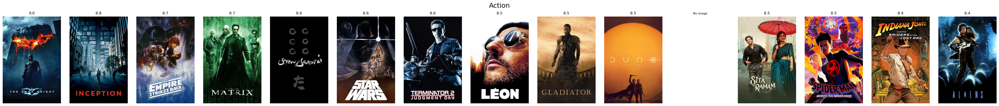

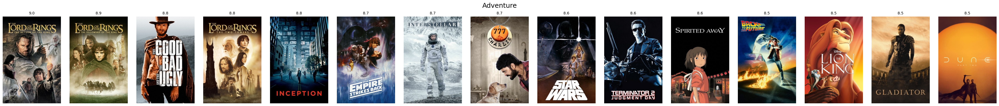

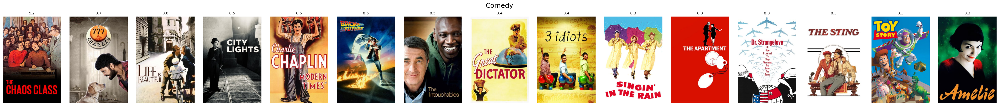

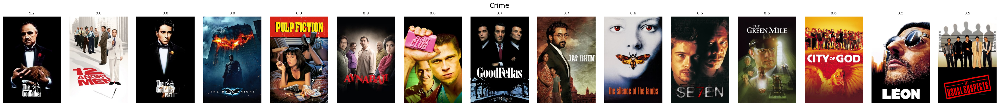

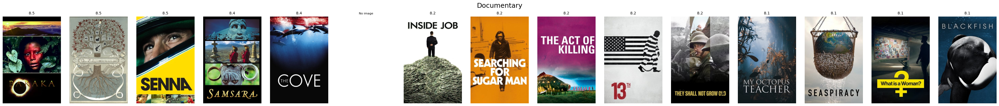

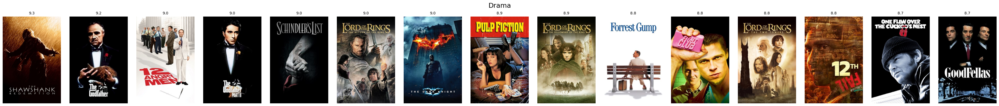

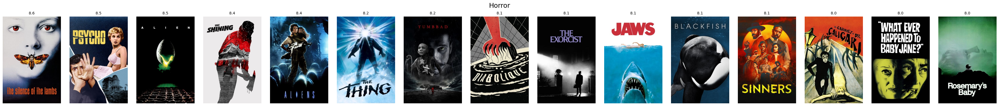

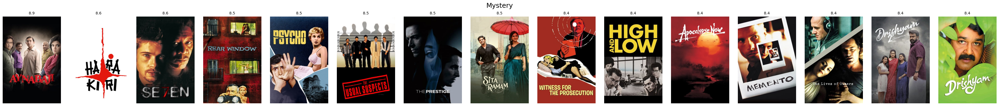

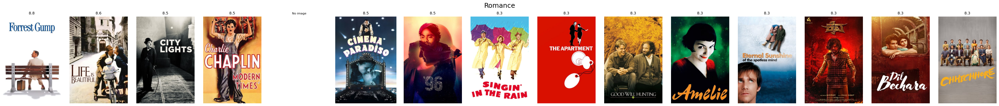

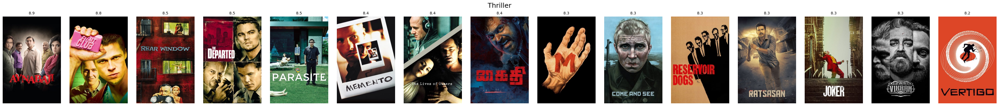

In [43]:
import matplotlib.pyplot as plt
from PIL import Image
from io import BytesIO
import requests

genres = top_movies_by_genre['genre'].unique()

for genre in genres:
    df_genre = top_movies_by_genre[top_movies_by_genre['genre'] == genre]

    fig, axes = plt.subplots(1, len(df_genre), figsize=(2.5 * len(df_genre), 4))
    fig.suptitle(genre, fontsize=18)

    # Ensure axes is always iterable
    if len(df_genre) == 1:
        axes = [axes]

    for i, (_, row) in enumerate(df_genre.iterrows()):
        ax = axes[i]
        try:
            if row["poster_url"]:
                response = requests.get(row["poster_url"])
                img = Image.open(BytesIO(response.content))
                ax.imshow(img)
                ax.axis("off")
                ax.set_title(f"{row['imdb_rating']}", fontsize=10)
            else:
                ax.axis("off")
                ax.set_title("No image", fontsize=8)
        except:
            ax.axis("off")
            ax.set_title("Error", fontsize=8)

    plt.tight_layout()
    plt.subplots_adjust(top=0.85)
    plt.show()
